# Logistic Regression 

## import library

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

## load training data

In [2]:
fname_data = 'assignment_08_data.csv'

data = np.genfromtxt(fname_data, delimiter=',')
num_data = data.shape[0]

point_x = np.zeros(num_data)
point_y = np.zeros(num_data)
label   = np.zeros(num_data)

for i in range(num_data):

    point_x[i]  = data[i,0]
    point_y[i]  = data[i,1]
    label[i]    = data[i,2]


## define linear regression function with inputs $\theta = (\theta_0, \theta_1, \theta_2)$ and ${\rm point} = (1, x, y)$

In [3]:
def linear_regression(*args):
    theta=args[0]
    point=args[1]
    value=np.sum(theta*point)
    return value

## define sigmoid function with input $x$

In [4]:
def sigmoid(*args):
    a=args[0]
    z=1/(1+np.exp(-a))
    return z

## define loss function for the logistic regression

In [5]:
def compute_loss(*args):
    theta=args[0]
    point=args[1]
    point_x=point[0]
    point_y=point[1]
    label=point[2]
    len_num=len(point_x)
    loss=0
    for i in range(len_num):
        h=sigmoid(linear_regression(theta,np.array((1,point_x[i],point_y[i]))))
        loss+=-label[i]*np.log(h)-(1-label[i])*np.log(1-h)
    loss=loss/len_num
    return loss

## define gradient vector for the model parameters $\theta = (\theta_0, \theta_1, \theta_2)$

In [6]:
def compute_gradient(*args):
    theta=args[0]
    point=args[1]
    point_x=point[0]
    point_y=point[1]
    label=point[2]
    len_num=len(point_x)
    gradient=np.zeros(3)
    for i in range(len_num):
        points=np.array((1,point_x[i],point_y[i]))
        h=sigmoid(linear_regression(theta,points))
        gradient+=(label[i]*(h-1))*points+((1-label[i])*h)*points
    gradient=gradient/len_num
    return gradient

## gradient descent for the model parameters $\theta = (\theta_0, \theta_1, \theta_2)$

In [7]:
num_iteration   = 5000  # USE THIS VALUE for the number of gradient descent iterations 
learning_rate   = 0.001 # USE THIS VALUE for the learning rate
theta           = np.array((0, 0, 0))   # USE THIS VALUE for the initial condition of the model parameters
points=np.array((point_x,point_y,label))
theta_iteration = np.zeros((num_iteration, theta.size))
loss_iteration  = np.zeros(num_iteration)

    

## iterations for the gradient descent

In [8]:
for i in range(num_iteration):
    theta1=theta-learning_rate*compute_gradient(theta,points)
    loss=compute_loss(theta,points)
    theta_iteration[i]=theta
    loss_iteration[i]=loss
    theta=theta1
    if i%400==0:
        print("iteration = %4d, loss = %5.5f" % (i, loss))

iteration =    0, loss = 0.69315
iteration =  400, loss = 0.13120
iteration =  800, loss = 0.11675
iteration = 1200, loss = 0.11210
iteration = 1600, loss = 0.10999
iteration = 2000, loss = 0.10889
iteration = 2400, loss = 0.10825
iteration = 2800, loss = 0.10786
iteration = 3200, loss = 0.10761
iteration = 3600, loss = 0.10745
iteration = 4000, loss = 0.10733
iteration = 4400, loss = 0.10726
iteration = 4800, loss = 0.10720


## plot the results

In [9]:
print(theta)
def plot_loss_curve(*args):
    loss_iteration=args[0]
    plt.figure(figsize=(8,6))   
    plt.title('loss')

    plt.plot(range(len(loss_iteration)),loss_iteration,'r-')


    plt.xlabel('iteration')
    plt.ylabel('loss')

    plt.tight_layout()
    plt.show()

[-0.02809329  0.36071584 -0.4335038 ]


In [10]:
def plot_data(*args):
    point_x=args[0]
    point_y=args[1]
    label=args[2]
    plt.figure(figsize=(8,8))
    for i in range(len(label)):
        if label[i]==1:
            break
    plt.title('training data')
    plt.plot(point_x[:i],point_y[:i], 'b.', label='class=0')
    plt.plot(point_x[i:],point_y[i:], 'r.', label='class=1')
    
    plt.axis('equal')
    plt.legend()
    plt.tight_layout()
    plt.show()

In [11]:

def plot_model_parameter(*args):
    theta_iteration=args[0]
    plt.figure(figsize=(8,6))
    plt.title('model parameter')
    plt.plot(range(len(theta_iteration)), theta_iteration.transpose()[0],'r-', label='theta0')
    plt.plot(range(len(theta_iteration)), theta_iteration.transpose()[1],'g-', label='theta1')
    plt.plot(range(len(theta_iteration)), theta_iteration.transpose()[2],'b-', label='theta0')
    plt.xlabel('iteration')
    plt.legend()

    plt.tight_layout()
    plt.show()

In [12]:
def plot_classifier(*args):
    plt.figure(figsize=(8,6))
    point_x=args[0]
    point_y=args[1]
    label=args[2]
    x1 = np.linspace(-20, 30)
    y1 = -(theta[0]+theta[1]*x1)/theta[2]
    xx=np.arange(-20,30,0.1)
    yy=np.arange(-20,30,0.1)
    XX,YY=np.meshgrid(xx,yy)
    ZZ=np.zeros((len(XX),len(YY)))
    zz=np.zeros((len(XX),len(YY)))
    for i in range(len(XX)):
        for j in range(len(YY)):     
            point=np.array((1,XX[0][j],YY[i][0]))
            zz[i,j]=linear_regression(theta,point)
            ZZ[i,j]=sigmoid(zz[i,j])
    plt.scatter(XX, YY, c=zz,cmap=plt.cm.RdBu_r)        
    for i in range(len(label)):
        if label[i]==1:
            break
    plt.plot(x1,y1,'k')
    plt.plot(point_x[:i],point_y[:i], 'b.', label='class=0')
    plt.plot(point_x[i:],point_y[i:], 'r.', label='class=1')
    
    
    
    plt.colorbar()
    plt.axis('equal')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

# * results

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

### # 01. plot the input data point in blue for class 0 and in red for class 1

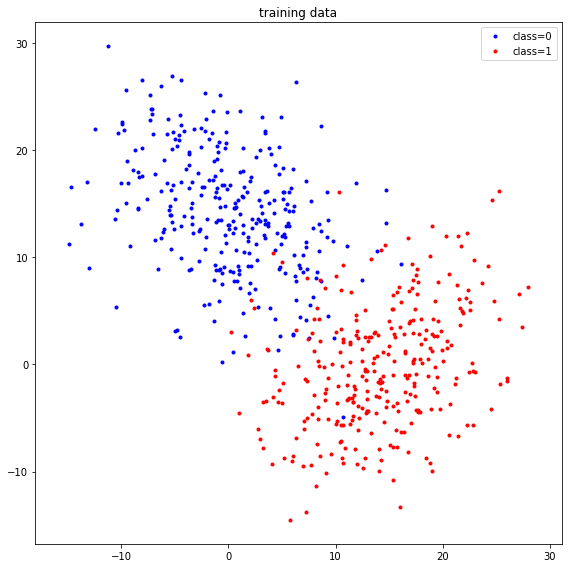

In [13]:
plot_data(point_x,point_y,label)

### # 02. plot the values of the model parameters $\theta_0$ in red curve, $\theta_1$ in green curve, and $\theta_2$ in blue curve over the gradient descent iterations

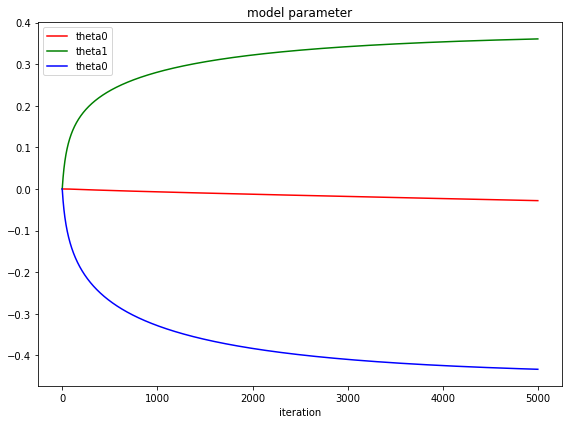

In [14]:
plot_model_parameter(theta_iteration)

### # 03. plot the loss values $\mathcal{L}(\theta)$ in red curve over the gradient descent iterations

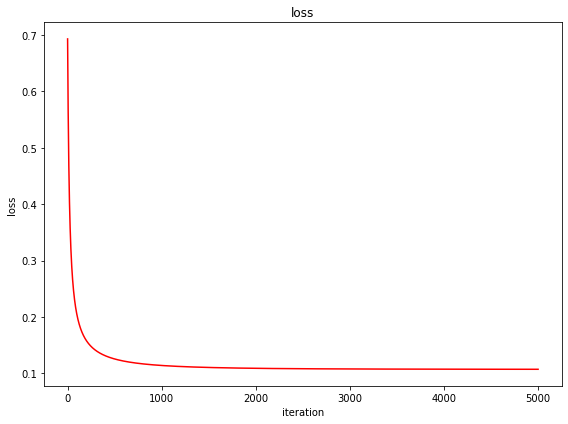

In [15]:
plot_loss_curve(loss_iteration)

### # 04. plot the classifier with the given data points superimposed

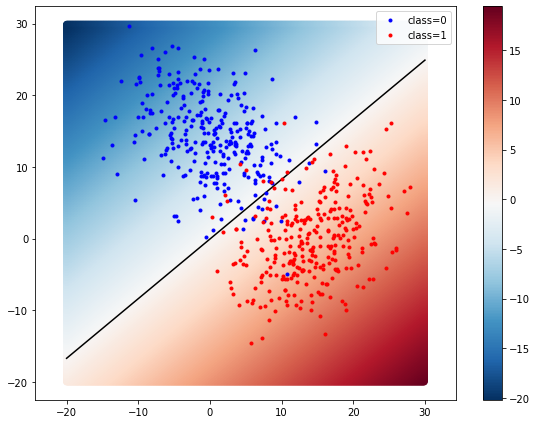

In [16]:
plot_classifier(point_x,point_y,label)